In [1]:
from data_builder.build_dataset import PlanetscopeDataset
import json
import cv2 
import numpy as np
import matplotlib.pyplot as plt

In [2]:
with open('eval_config.json', 'r') as f:
    eval_config = json.load(f)

In [3]:
print("Test Configuration")
print(json.dumps(eval_config, indent=1))

Test Configuration
{
 "DATASET_PATH": "/scratch/aghosh57/SAT-SAM(Dataset)/ps_rwanda/all_dataset/",
 "REGION": "France-1.14_run4",
 "MODEL": "SAT-SAM",
 "NMS_THRESHOLD": 0.9,
 "PRED_CONFIDENCE_THRESHOLD": 0.6,
 "ENSEMBLE_BOX_THRESHOLD": 0.5,
 "ENSEMBLE_BOX_BETA": 0.4,
 "RPN_MODEL_PATH": "rpn/checkpoint/rpn_model_1.14_Fr_Rw.pth",
 "SAM_MODEL_PATH": "sam/checkpoint/sam_vit_l_0b3195.pth"
}


In [4]:
dataset = PlanetscopeDataset(eval_config['DATASET_PATH'], train=False)

In [5]:
def contrast_based_adaptive_gamma_correction(image, alpha=1.0, beta=1.0):
    # Convert image to float32 for calculations
    img_float = image.astype(np.float32) / 255.0
    
    # Calculate local contrast using Laplacian operator
    laplacian = cv2.Laplacian(img_float, cv2.CV_32F)
    local_contrast = np.abs(laplacian)
    
    # Calculate adaptive gamma based on local contrast
    adaptive_gamma = np.power(local_contrast, alpha)
    
    # Apply gamma correction
    corrected_image = np.power(img_float, adaptive_gamma) * beta
    
    # Convert back to uint8 format
    corrected_image = np.clip(corrected_image * 255.0, 0, 255).astype(np.uint8)
    
    return corrected_image

In [6]:
def gamma_correction(img):
    img = img.astype(float)
    img = (255 * (img - np.min(img[:])) / (np.max(img[:]) - np.min(img[:]) + 0.1)).astype(float)
    img = (img + 0.5) / 256
    gamma = -1/np.nanmean(np.log(img))
    img = img**(gamma)
    return img

In [7]:
def histogram_equalization(image):
    # Convert image to grayscale if it's in color
    if len(image.shape) == 3:
        gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    else:
        gray = image

    # Apply histogram equalization
    equalized = cv2.equalizeHist(gray)

    return equalized

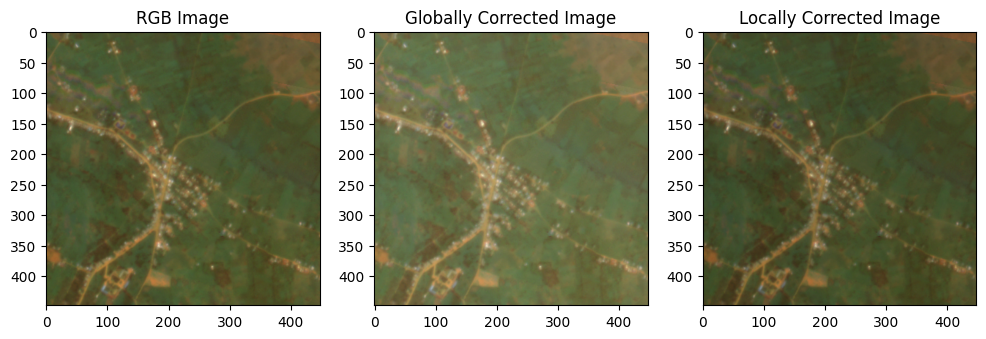

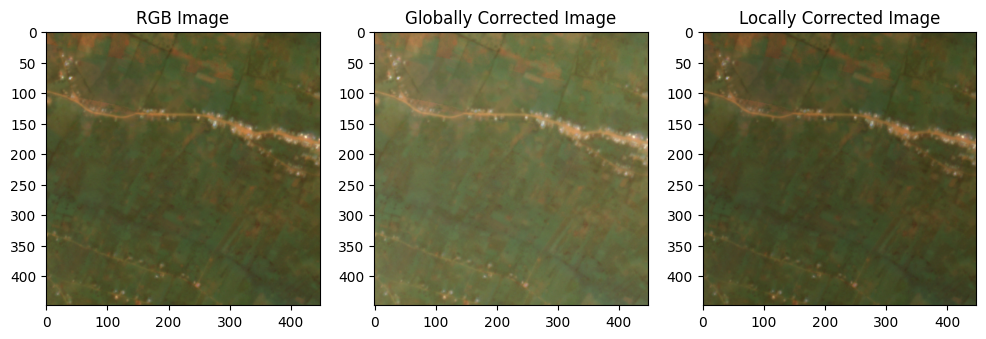

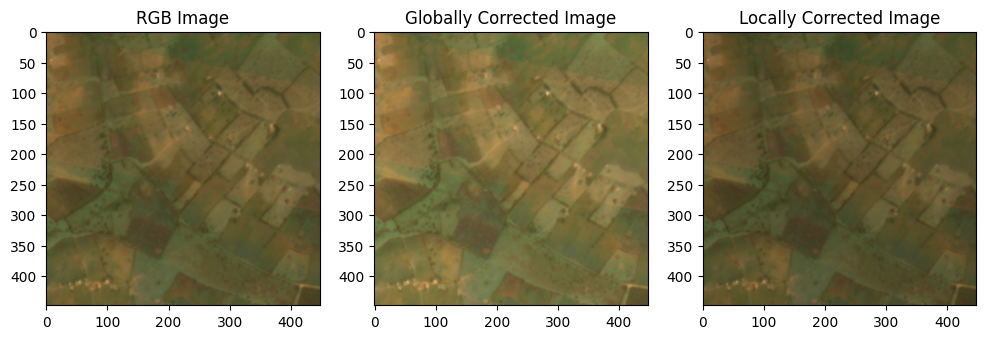

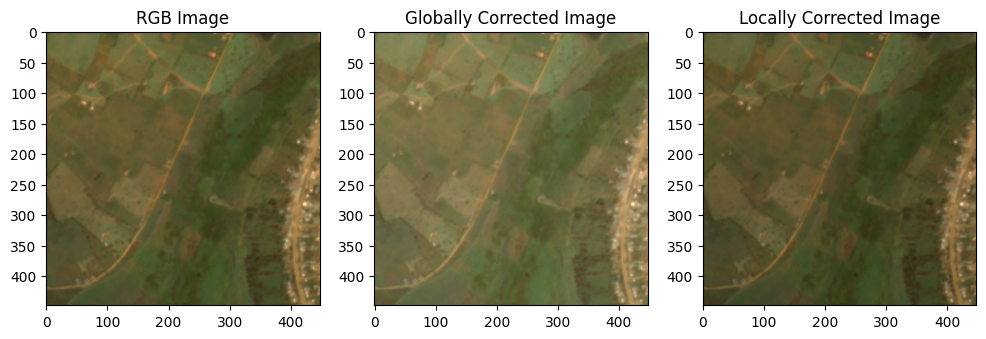

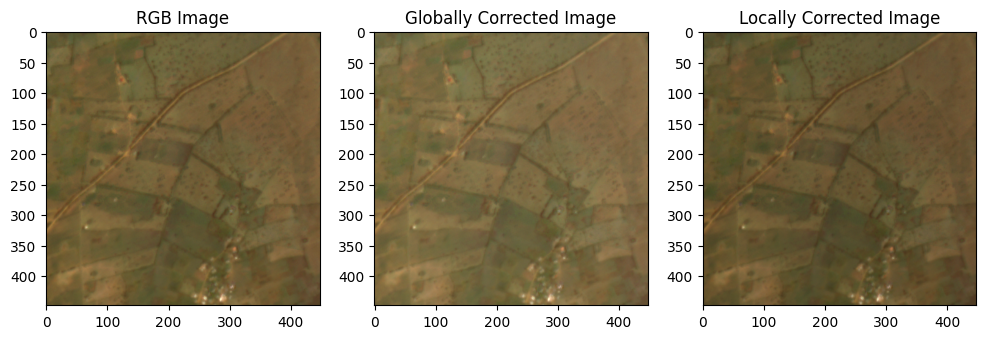

...

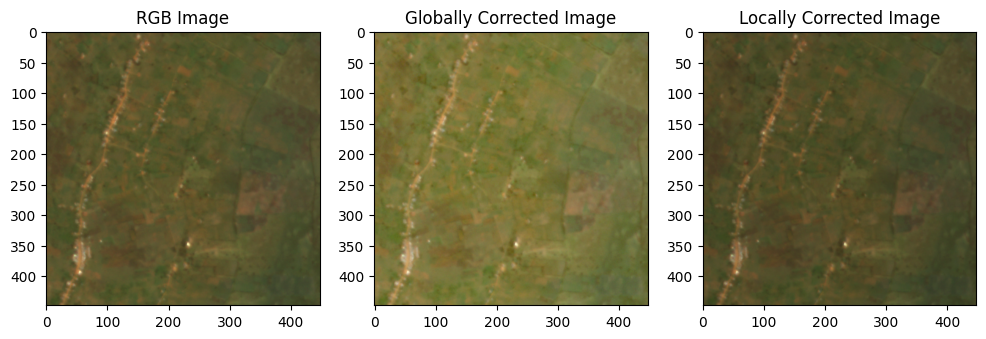

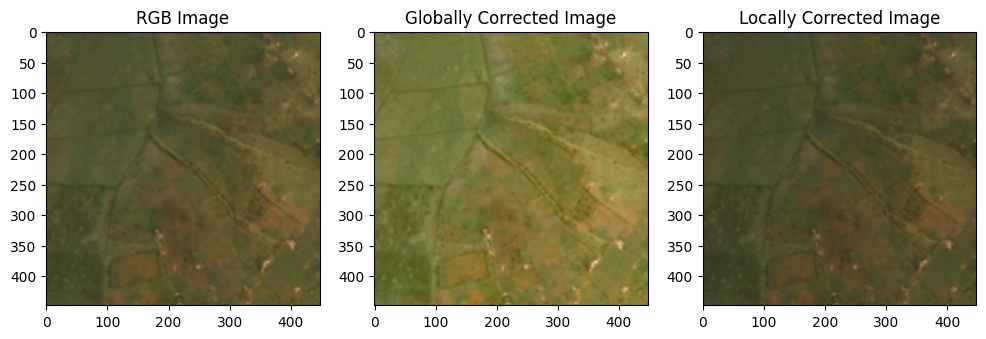

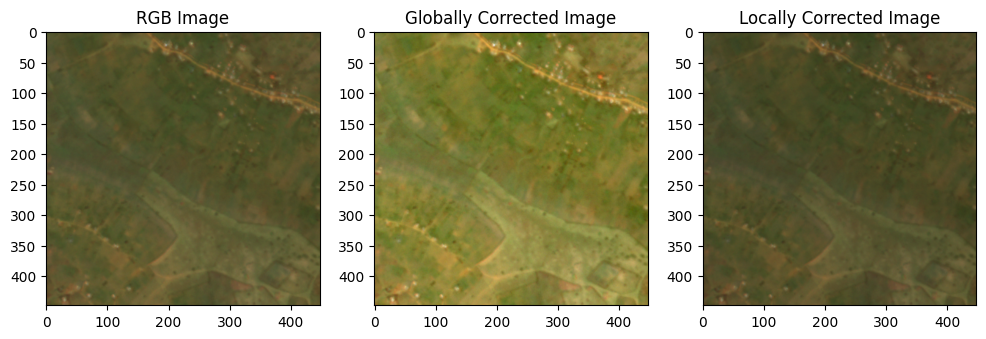

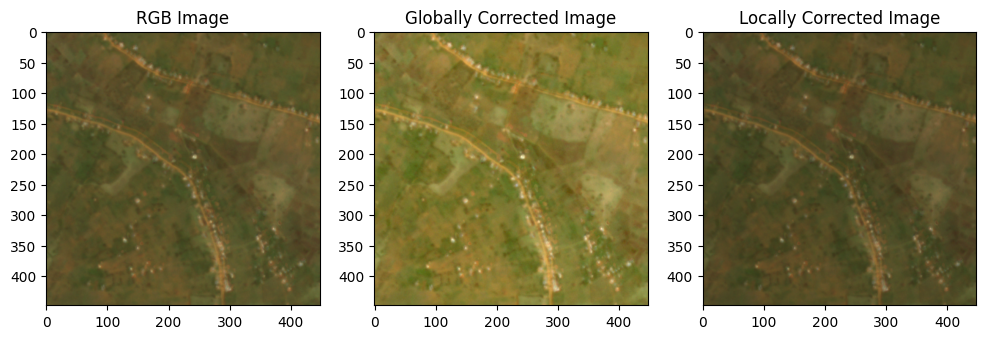

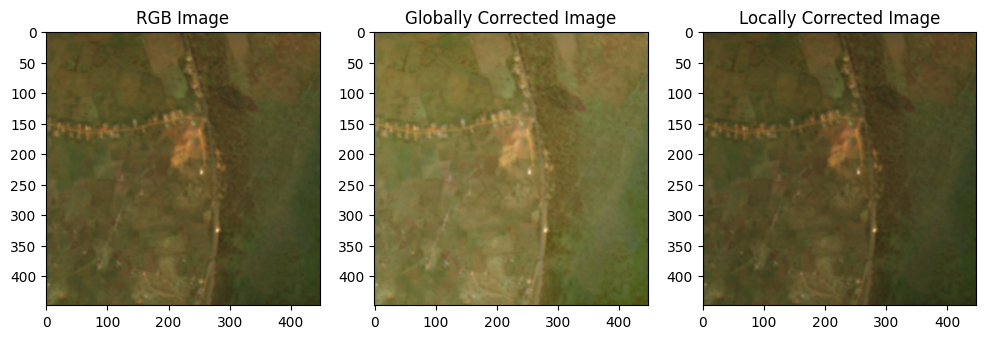

In [8]:
for rgb_image, rpn_image, target, ensemble in dataset:
    
    globally_corrected_image = gamma_correction(np.array(rgb_image))
    locally_corrected_image = contrast_based_adaptive_gamma_correction(np.array(rgb_image), alpha=0, beta=0.9)
    
    plt.subplots(1, 3, figsize=(12, 4))
    
    plt.subplot(1, 3, 1)
    plt.imshow(rgb_image)
    plt.title('RGB Image')

    plt.subplot(1, 3, 2)
    plt.imshow(globally_corrected_image)
    plt.title('Globally Corrected Image')

    plt.subplot(1, 3, 3)
    plt.imshow(locally_corrected_image)
    plt.title('Locally Corrected Image')

    plt.show()